In [21]:
import seaborn as sns 
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import numpy as np
from mlxtend.plotting import plot_pca_correlation_graph
import seaborn as sns
from sklearn.neighbors import KNeighborsClassifier, NeighborhoodComponentsAnalysis
from sklearn.model_selection import KFold, cross_val_score, StratifiedKFold, train_test_split
from modules.utils import add_decision_boundary, plot_clustering, better_decision_boundary
from sklearn.metrics import accuracy_score
from sklearn.metrics import plot_confusion_matrix
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import confusion_matrix
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.metrics import adjusted_rand_score
from sklearn.utils.multiclass import unique_labels
from sklearn.preprocessing import StandardScaler, MinMaxScaler, Normalizer, RobustScaler
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from sklearn.pipeline import Pipeline
import itertools
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis


In [2]:
data = pd.read_csv('column_3C_weka.csv')


In [3]:
data.head()

,pelvic_incidence,pelvic_tilt,lumbar_lordosis_angle,sacral_slope,pelvic_radius,degree_spondylolisthesis,class
0,63.027818,22.552586,39.609117,40.475232,98.672917,-0.254400,Hernia
1,39.056951,10.060991,25.015378,28.995960,114.405425,4.564259,Hernia
2,68.832021,22.218482,50.092194,46.613539,105.985135,-3.530317,Hernia
3,69.297008,24.652878,44.311238,44.644130,101.868495,11.211523,Hernia
4,49.712859,9.652075,28.317406,40.060784,108.168725,7.918501,Hernia


In [4]:
data_melted = data.melt(id_vars=['class'])

# Box plot

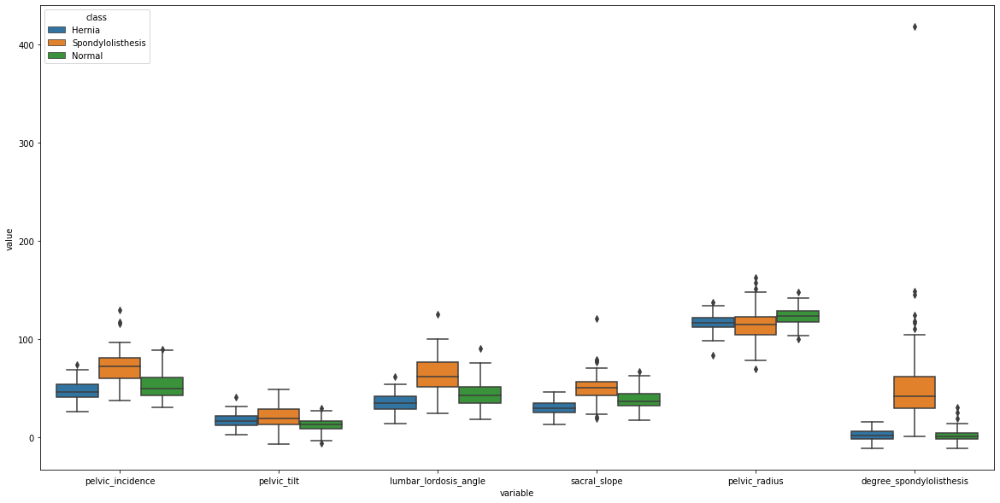

In [5]:
plt.figure(figsize=(20,10))
sns.boxplot(x= 'variable', y='value', data = data_melted, hue ='class')
# plt.xticks(rotation=45)
plt.show()

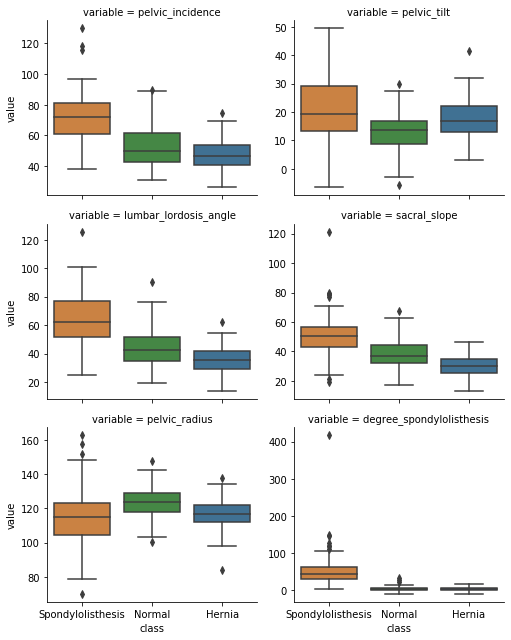

In [6]:
d = {'color': ['r', 'b','k']}
ordered_class = data_melted["class"].value_counts().index
facet = sns.FacetGrid(data_melted, col="variable", sharey=False, col_wrap=2, aspect=1.2)
facet.map(sns.boxplot, "class", "value", data=data_melted, palette=["#e1812c", "#3a923a", "#3274a1"], order=ordered_class)

# Nombre d'individus pour chaque classe

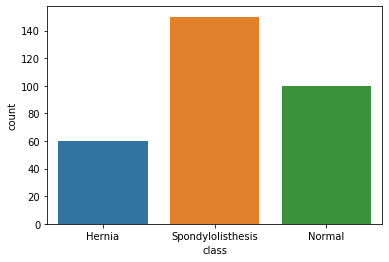

In [7]:
sns.countplot(data['class'])
plt.show()


# Scatter plot

In [3]:
#On enlève la valeur abérrante de degree_spondylolisthesis
data = data[data.degree_spondylolisthesis<200]

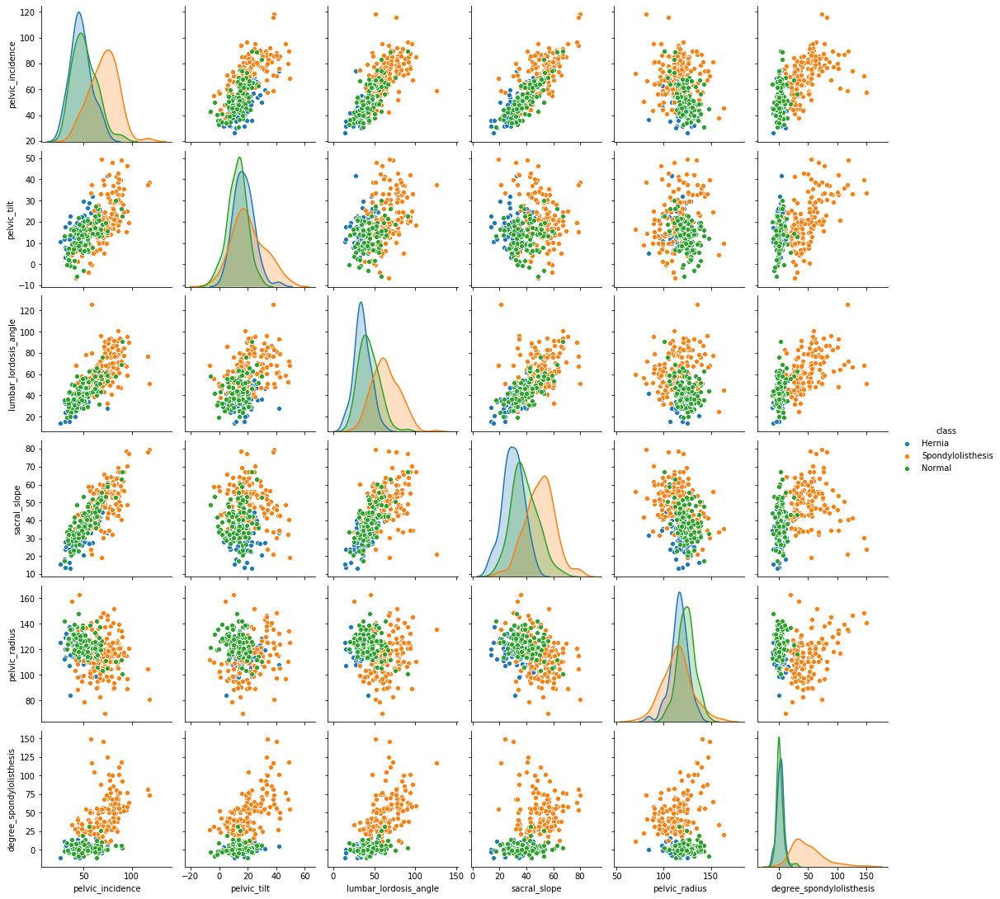

In [9]:
sns.pairplot(data, hue="class", height=2.5);

In [5]:
x_data = data.iloc[:,0:-1]
x_data.head()


,pelvic_incidence,pelvic_tilt,lumbar_lordosis_angle,sacral_slope,pelvic_radius,degree_spondylolisthesis
0,63.027818,22.552586,39.609117,40.475232,98.672917,-0.254400
1,39.056951,10.060991,25.015378,28.995960,114.405425,4.564259
2,68.832021,22.218482,50.092194,46.613539,105.985135,-3.530317
3,69.297008,24.652878,44.311238,44.644130,101.868495,11.211523
4,49.712859,9.652075,28.317406,40.060784,108.168725,7.918501


# Corrélation des données

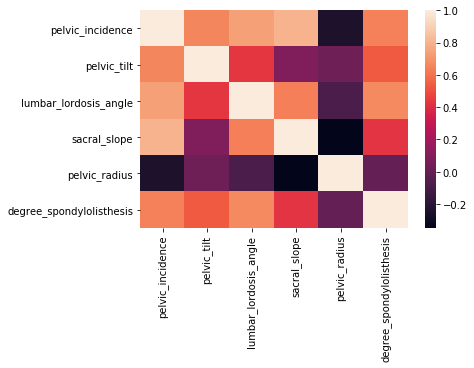

In [11]:
corr = data.corr()
sns.heatmap(corr)


# ACP

[6.85860465e+01 1.46657360e+01 7.67730216e+00 5.24197142e+00
 3.82894383e+00 3.64085395e-19]


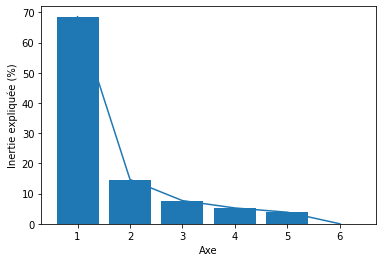

In [6]:
cls = PCA(n_components=6)
# scaler = MinMaxScaler()
# x_data = scaler.fit_transform(x_data)
pcs = cls.fit_transform(x_data)
print(cls.explained_variance_ratio_ * 100)

plt.plot(np.arange(1,7),cls.explained_variance_ratio_ * 100)
plt.bar(np.arange(1,7),cls.explained_variance_ratio_ * 100)
plt.ylabel("Inertie expliquée (%)")
plt.xlabel("Axe")
plt.show()

In [7]:
data_pca = np.hstack((data[['class']].to_numpy(), pcs))
data_pca = pd.DataFrame(data_pca)
data_pca = data_pca.rename(columns={i:f'Axe {i}' for i in range(1,7)}).rename(columns={0:'class'})
data_pca.head()

,class,Axe 1,Axe 2,Axe 3,Axe 4,Axe 5,Axe 6
0,Hernia,-22.8001,-18.9538,11.87,12.5064,4.89633,-2.43516e-10
1,Hernia,-39.3735,10.6312,13.6695,-0.199405,-0.716414,1.12847e-10
2,Hernia,-17.6972,-25.2861,-1.24907,10.3897,3.209,-1.5679e-10
3,Hernia,-8.39721,-17.4038,9.67597,13.1552,1.76528,5.5266e-09
4,Hernia,-28.7779,-1.54824,16.0662,0.343055,-6.24413,-4.49284e-10


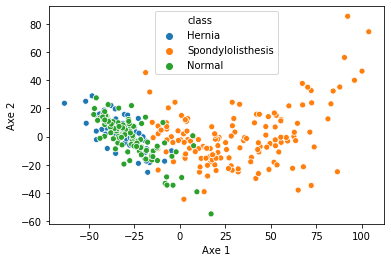

In [14]:
sns.scatterplot(x='Axe 1', y='Axe 2', hue='class', data= data_pca)


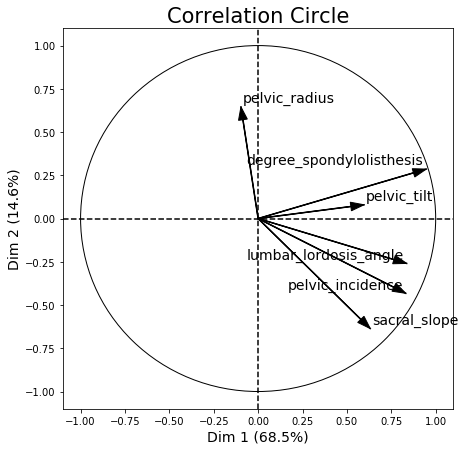

In [15]:
figure, correlation_matrix = plot_pca_correlation_graph(x_data, x_data.columns, dimensions=(1, 2), figure_axis_size=7, X_pca=pcs[:,0:2], explained_variance= cls.explained_variance_[0:2])


## Acp sans la variable degree_spondylolisthesis


[6.45801428e+01 1.80033409e+01 1.00593232e+01 7.35719314e+00
 6.76343609e-19]


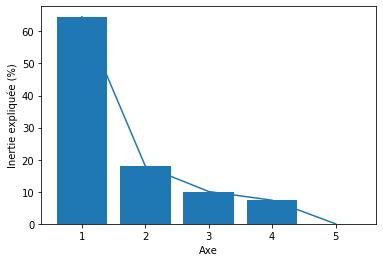

In [16]:
x_without_spond = x_data.drop(columns="degree_spondylolisthesis")
cls2 = PCA(n_components=5)
# scaler = MinMaxScaler()
# x_data = scaler.fit_transform(x_data)
pcs2 = cls2.fit_transform(x_without_spond)
print(cls2.explained_variance_ratio_ * 100)

plt.plot(np.arange(1,6),cls2.explained_variance_ratio_ * 100)
plt.bar(np.arange(1,6),cls2.explained_variance_ratio_ * 100)
plt.ylabel("Inertie expliquée (%)")
plt.xlabel("Axe")
plt.show()

In [17]:
data_pca2 = np.hstack((data[['class']].to_numpy(), pcs2))
data_pca2 = pd.DataFrame(data_pca2)
data_pca2 = data_pca2.rename(columns={i:f'Axe {i}' for i in range(1,7)}).rename(columns={0:'class'})
data_pca2.head()

,class,Axe 1,Axe 2,Axe 3,Axe 4,Axe 5
0,Hernia,-3.48279,-19.0852,13.2178,3.18126,-2.13338e-10
1,Hernia,-36.6917,-8.77403,2.78105,0.983562,9.22328e-11
2,Hernia,8.15422,-11.359,7.83048,-0.0907024,-1.02227e-10
3,Hernia,5.00961,-15.6743,13.4738,0.0836851,5.54974e-09
4,Hernia,-22.9354,-16.711,2.56365,-4.81894,-4.67543e-10


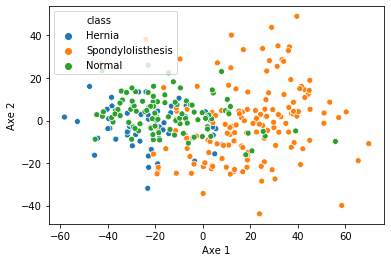

In [18]:
sns.scatterplot(x='Axe 1', y='Axe 2', hue='class', data= data_pca2)

# K-means

On teste l'efficacité du modèle KMeans sur notre dataset en comparant les clusters qu'il donne en résultat avec la séparation réelle des données en classe. Notre connaissance du jeu de données nous permet de connaître le nombre de clusters à considérer. On applique donc successivement la méthode sur 2 et 3 clusters.

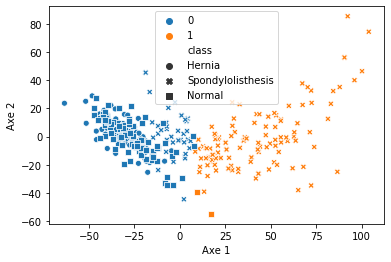

In [19]:
data_pca_quant = data_pca.drop(columns="class")
km2 = KMeans (n_clusters=2, init="random")
km2.fit(data_pca_quant)
sns.scatterplot(x='Axe 1', y='Axe 2', data= data_pca_quant, hue=km2.labels_, style=data_pca['class'])

En appliquant KMeans pour 2 clusters, on obtient un cluster réunissant *Hernia* et *Normal* et un autre contenant *Spondylolithesis*. 


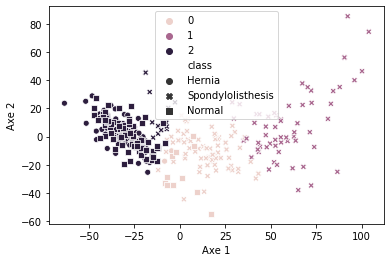

In [21]:
#On applique désormais les KMeans pour 3 clusters
km3 = KMeans (n_clusters=3, init="random")
km3.fit(data_pca_quant)
sns.scatterplot(x='Axe 1', y='Axe 2', data= data_pca_quant, hue=km3.labels_, style=data_pca['class'])

Avec K=3, on observe que la partition obtenue est très différente de la partition réelle. En effet, la classe Spondylolisthesis est scindée entre deux clusters tandis que Normal et Hernia sont une fois encore rassemblé en une unique classe. 

Le calcul de l'indice de Rand ajusté confirme ces observations. 

In [22]:
adjusted_rand_score(data_pca['class'], km3.labels_)

0.30850540715803065

# Train-test split

## Originales

In [117]:
X = data.iloc[:, 0:-1]
y = data['class']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=1/3, random_state=42, stratify=y)

In [118]:
X_train

,pelvic_incidence,pelvic_tilt,lumbar_lordosis_angle,sacral_slope,pelvic_radius,degree_spondylolisthesis
33,38.663257,12.986441,40.000000,25.676816,124.914118,2.703008
114,80.988074,36.843172,86.960602,44.144903,141.088149,85.872152
274,43.191915,9.976664,28.938149,33.215251,123.467400,1.741018
231,53.911054,12.939318,39.000000,40.971736,118.193035,5.074353
221,54.950970,5.865353,53.000000,49.085617,126.970328,-0.631603
...,...,...,...,...,...,...
19,41.729963,12.254074,30.122586,29.475889,116.585706,-1.244402
195,71.241764,5.268270,85.999584,65.973493,110.703107,38.259864
81,74.005541,21.122402,57.379502,52.883139,120.205963,74.555166
162,118.144655,38.449501,50.838520,79.695154,81.024541,74.043767


## PCA

In [119]:
cls = PCA(n_components=6)
X_train_pca = pd.DataFrame(cls.fit_transform(X_train))
X_train_pca = X_train_pca.rename(columns={i:f'Axe {i+1}' for i in range(0,6)})

## Sans pelvic incidence

In [120]:
X_train_5c = X_train.drop(columns=['pelvic_incidence'])
X_test_5c = X_test.drop(columns=['pelvic_incidence'])


# Apprentissage

In [39]:
def one_grid_search(X, y, model, parameters):
  
    clf = GridSearchCV(model, parameters, scoring="accuracy", cv=5, n_jobs=-1, refit=True)
    clf.fit(X, y)

    scores = clf.cv_results_['mean_test_score']

    detailed_scores = pd.concat([pd.DataFrame(clf.cv_results_["params"]),pd.DataFrame(clf.cv_results_["mean_test_score"], columns=["Accuracy"])],axis=1).sort_values(by=['Accuracy'], ascending=False)

    return clf.best_params_, clf.best_score_, detailed_scores, clf.best_estimator_

In [40]:
def grid_search(model, parameters):
    pipe1 = Pipeline([('standard', StandardScaler()), ('nca', NeighborhoodComponentsAnalysis())])
    pipe2 = Pipeline([('minmax', MinMaxScaler()), ('nca', NeighborhoodComponentsAnalysis())])
    pipe3 = Pipeline([('standard', StandardScaler()), ('nca', NeighborhoodComponentsAnalysis(2))])
    pipe4 = Pipeline([('minmax', MinMaxScaler()), ('nca', NeighborhoodComponentsAnalysis(2))])
    pipe5 = Pipeline([('standard', StandardScaler()), ('adl', LinearDiscriminantAnalysis())])
    pipe6 = Pipeline([('minmax', MinMaxScaler()), ('adl', LinearDiscriminantAnalysis())])
    pipe7 = Pipeline([('standard', StandardScaler()), ('adl', LinearDiscriminantAnalysis(n_components=2))])
    pipe8 = Pipeline([('minmax', MinMaxScaler()), ('adl', LinearDiscriminantAnalysis(n_components=2))])

    Xs = [('without_pelvic',X_train_5c), 
        ('original',X_train),

        ('standard+NCA', pipe1.fit_transform(X_train, y_train)),
        ('without_pelvic+standard+NCA', pipe1.fit_transform(X_train_5c, y_train)),
        
        ('minmax+NCA', pipe2.fit_transform(X_train, y_train)),
        ('without_pelvic+minmax+NCA', pipe2.fit_transform(X_train_5c, y_train)),

        ('NCA', NeighborhoodComponentsAnalysis().fit_transform(X_train,y_train)),
        ('without_pelvic+NCA', NeighborhoodComponentsAnalysis().fit_transform(X_train_5c,y_train)),


        ('standard+NCA(2)', pipe3.fit_transform(X_train, y_train)),
        ('without_pelvic+standard+NCA(2)', pipe3.fit_transform(X_train_5c, y_train)),
        
        ('minmax+NCA(2)', pipe4.fit_transform(X_train, y_train)),
        ('without_pelvic+minmax+NCA(2)', pipe4.fit_transform(X_train_5c, y_train)),

        ('NCA(2)', NeighborhoodComponentsAnalysis(2).fit_transform(X_train,y_train)),
        ('without_pelvic+NCA(2)', NeighborhoodComponentsAnalysis(2).fit_transform(X_train_5c,y_train)),



        ('standard+ADL', pipe5.fit_transform(X_train, y_train)),
        ('without_pelvic+standard+ADL', pipe5.fit_transform(X_train_5c, y_train)),
        
        ('minmax+ADL', pipe5.fit_transform(X_train, y_train)),
        ('without_pelvic+minmax+ADL', pipe6.fit_transform(X_train_5c, y_train)),

        ('ADL', NeighborhoodComponentsAnalysis().fit_transform(X_train,y_train)),
        ('without_pelvic+ADL', NeighborhoodComponentsAnalysis().fit_transform(X_train_5c,y_train)),

        ('standard+ADL(2)', pipe7.fit_transform(X_train, y_train)),
        ('without_pelvic+standard+ADL(2)', pipe7.fit_transform(X_train_5c, y_train)),
        
        ('minmax+ADL(2)', pipe8.fit_transform(X_train, y_train)),
        ('without_pelvic+minmax+ADL(2)', pipe8.fit_transform(X_train_5c, y_train)),

        ('ADL(2)', NeighborhoodComponentsAnalysis(2).fit_transform(X_train,y_train)),
        ('without_pelvic+ADL(2)', NeighborhoodComponentsAnalysis(2).fit_transform(X_train_5c,y_train)),



        ('standard', StandardScaler().fit_transform(X_train)),
        ('without_pelvic+standard', StandardScaler().fit_transform(X_train_5c)),

        ('minmax', MinMaxScaler().fit_transform(X_train)),
        ('without_pelvic+minmax', MinMaxScaler().fit_transform(X_train_5c)),
        
        ('ACP2', X_train_pca[['Axe 1', 'Axe 2']]),
        ('ACP3', X_train_pca[['Axe 1', 'Axe 2','Axe 3']]),
        ('ACP4',X_train_pca[['Axe 1', 'Axe 2','Axe 3', 'Axe 4']]),
        ('ACP5',X_train_pca[['Axe 1', 'Axe 2','Axe 3', 'Axe 4', 'Axe 5']])
    ]

    scores = []
    for X in Xs:
        method, X = X
        best_params, best_score, detailed_scores, best_estimator = one_grid_search(X, y_train, model, parameters)
        scores.append([method, best_params, best_score, detailed_scores, best_estimator])
        print(f'{method}: {best_score*100:0.2f}')
    
    scores = pd.DataFrame(np.array(scores), columns=['method', 'best_params','best_score', 'detailed_scores', 'best_estimator']).sort_values(by=['best_score'], ascending=False)

    return scores


# Knn


cross_val_score utilise un `StratifiedKFold`, ce qui permet de conserver la répartition d'origine des classes dans chaque Fold.

In [41]:
parameters = {'n_neighbors':list(range(1, 100)), 'weights':['uniform', 'distance']}
scores = grid_search(KNeighborsClassifier(n_jobs=-1), parameters)

without_pelvic: 86.88
original: 85.42
standard+NCA: 87.38
without_pelvic+standard+NCA: 86.90
minmax+NCA: 90.28
without_pelvic+minmax+NCA: 89.79
NCA: 86.85
without_pelvic+NCA: 87.36
standard+NCA(2): 90.74
without_pelvic+standard+NCA(2): 88.83
minmax+NCA(2): 90.27
without_pelvic+minmax+NCA(2): 89.80
NCA(2): 89.77
without_pelvic+NCA(2): 89.78
standard+ADL: 87.34
without_pelvic+standard+ADL: 87.34
minmax+ADL: 87.34
without_pelvic+minmax+ADL: 87.34
ADL: 86.85
without_pelvic+ADL: 87.36
standard+ADL(2): 87.34
without_pelvic+standard+ADL(2): 87.34
minmax+ADL(2): 87.34
without_pelvic+minmax+ADL(2): 87.34
ADL(2): 89.77
without_pelvic+ADL(2): 89.78
standard: 81.53
without_pelvic+standard: 82.01
minmax: 81.99
without_pelvic+minmax: 82.00
ACP2: 79.59
ACP3: 83.47
ACP4: 83.48
ACP5: 85.42


In [42]:
# Meilleur classifieur
print(scores.iloc[0].best_estimator)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=14, p=2,
                     weights='distance')


In [44]:
scores

,method,best_params,best_score,detailed_scores,best_estimator
8,standard+NCA(2),"{'n_neighbors': 14, 'weights': 'distance'}",0.907433,n_neighbors weights Accuracy 27 ...,"KNeighborsClassifier(algorithm='auto', leaf_si..."
4,minmax+NCA,"{'n_neighbors': 1, 'weights': 'uniform'}",0.902787,n_neighbors weights Accuracy 0 ...,"KNeighborsClassifier(algorithm='auto', leaf_si..."
10,minmax+NCA(2),"{'n_neighbors': 85, 'weights': 'distance'}",0.902671,n_neighbors weights Accuracy 169 ...,"KNeighborsClassifier(algorithm='auto', leaf_si..."
11,without_pelvic+minmax+NCA(2),"{'n_neighbors': 5, 'weights': 'uniform'}",0.898026,n_neighbors weights Accuracy 13 ...,"KNeighborsClassifier(algorithm='auto', leaf_si..."
5,without_pelvic+minmax+NCA,"{'n_neighbors': 1, 'weights': 'uniform'}",0.897909,n_neighbors weights Accuracy 0 ...,"KNeighborsClassifier(algorithm='auto', leaf_si..."
25,without_pelvic+ADL(2),"{'n_neighbors': 1, 'weights': 'uniform'}",0.897793,n_neighbors weights Accuracy 0 ...,"KNeighborsClassifier(algorithm='auto', leaf_si..."
13,without_pelvic+NCA(2),"{'n_neighbors': 1, 'weights': 'uniform'}",0.897793,n_neighbors weights Accuracy 0 ...,"KNeighborsClassifier(algorithm='auto', leaf_si..."
12,NCA(2),"{'n_neighbors': 6, 'weights': 'distance'}",0.897677,n_neighbors weights Accuracy 11 ...,"KNeighborsClassifier(algorithm='auto', leaf_si..."
24,ADL(2),"{'n_neighbors': 6, 'weights': 'distance'}",0.897677,n_neighbors weights Accuracy 11 ...,"KNeighborsClassifier(algorithm='auto', leaf_si..."
9,without_pelvic+standard+NCA(2),"{'n_neighbors': 4, 'weights': 'distance'}",0.888269,n_neighbors weights Accuracy 7 ...,"KNeighborsClassifier(algorithm='auto', leaf_si..."


In [46]:
pipe = Pipeline([('standard', StandardScaler()), ('nca', NeighborhoodComponentsAnalysis(2))])
pipe.fit(X_train, y_train)
X_test_transformed = pipe.transform(X_test)

Meilleure accuracy 0.9074332171893147 pour k=14


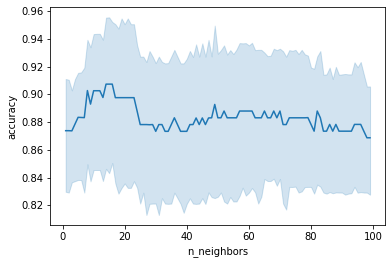

In [48]:
n_neighbors_list = range(1, 100)
accuracies = []
for n_neighbors in n_neighbors_list:
    cls = KNeighborsClassifier(n_neighbors=n_neighbors, weights='distance')
    accuracies.append(cross_val_score(cls, pipe.fit_transform(X_train, y_train), y_train, cv=5, scoring='accuracy'))

val_scores = pd.DataFrame(accuracies)
val_scores['moyenne'] = val_scores.mean(axis=1)
val_scores['n_neighbors'] = n_neighbors_list
melted_val_scores = val_scores.melt(id_vars='n_neighbors', value_name='accuracy')

sns.lineplot(x='n_neighbors', y='accuracy', data=melted_val_scores )
idx = val_scores['moyenne'].idxmax()
print(f"Meilleure accuracy {val_scores['moyenne'][idx]} pour k={val_scores['n_neighbors'][idx]}")
plt.show()

In [229]:
scores.iloc[0].detailed_scores


,n_neighbors,weights,Accuracy
27,14,distance,0.907433
29,15,distance,0.907433
31,16,distance,0.907433
15,8,distance,0.902787
21,11,distance,0.902671
...,...,...,...
182,92,uniform,0.722880
190,96,uniform,0.718002
192,97,uniform,0.718002
194,98,uniform,0.718002


In [231]:
y_pred = scores.iloc[0].best_estimator.predict(X_test_transformed)
accuracy_score(y_pred=y_pred, y_true=y_test)

0.8155339805825242

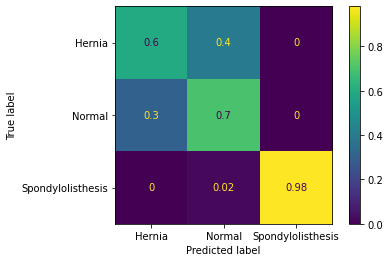

In [49]:
plot_confusion_matrix(scores.iloc[0].best_estimator, X_test_transformed, y_test, normalize='true')
plt.show()

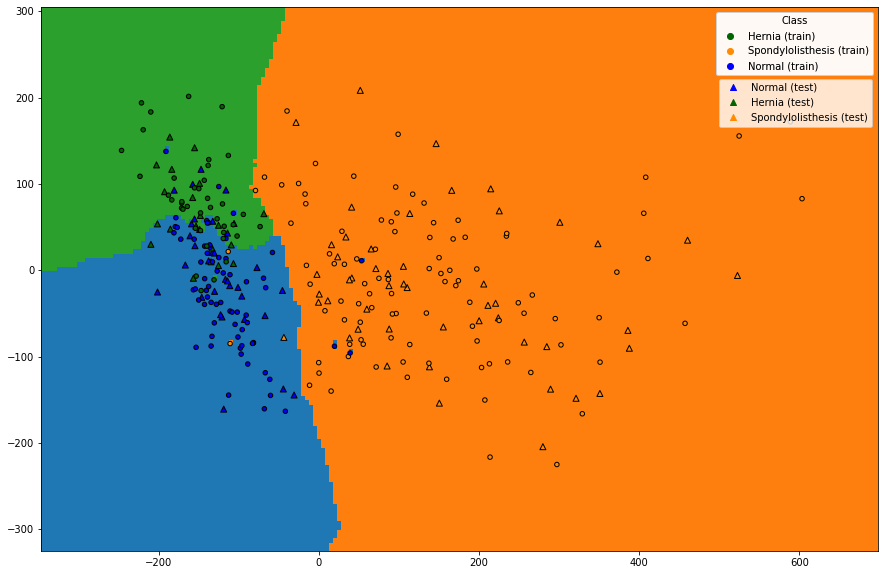

In [56]:
from matplotlib.colors import ListedColormap

X_db = pipe.fit_transform(X_train, y_train)
y_db, labels = pd.factorize(y_train)
clf = scores.iloc[0].best_estimator

better_decision_boundary(clf, X_db, y_db, labels, X_test_transformed, y_test)
plt.savefig('decision_boundary_knn')

## Régression logistique

In [8]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

X_train_5c = X_train.drop(columns=["pelvic_incidence"])

### Choix des paramètres : penalty par défaut, choix sur solver
- For small datasets, ‘liblinear’ is a good choice
- MAIS For multiclass problems, only ‘newton-cg’, ‘sag’, ‘saga’ and ‘lbfgs’ handle multinomial loss
- ‘sag’ and ‘saga’ fast convergence is only guaranteed on features with approximately the same scale. You can preprocess the data with a scaler 



In [122]:
solver_list = ['newton-cg', 'lbfgs', 'sag', 'saga']
parameters = dict(solver=solver_list)
scores = grid_search(LogisticRegression(random_state=32, multi_class="auto", n_jobs=-1, C=1), parameters)

without_pelvic: 85.40
original: 83.47
standard+NCA: 83.46
without_pelvic+standard+NCA: 83.95
minmax+NCA: 85.40
without_pelvic+minmax+NCA: 85.39
NCA: 83.46
without_pelvic+NCA: 84.92
standard+NCA(2): 83.93
without_pelvic+standard+NCA(2): 83.93
minmax+NCA(2): 83.93
without_pelvic+minmax+NCA(2): 85.40
NCA(2): 84.43
without_pelvic+NCA(2): 85.90
standard+ADL: 83.47
without_pelvic+standard+ADL: 83.47
minmax+ADL: 83.47
without_pelvic+minmax+ADL: 83.47
ADL: 83.46
without_pelvic+ADL: 84.92
standard+ADL(2): 83.47
without_pelvic+standard+ADL(2): 83.47
minmax+ADL(2): 83.47
without_pelvic+minmax+ADL(2): 83.47
ADL(2): 84.43
without_pelvic+ADL(2): 85.90
standard: 83.95
without_pelvic+standard: 83.47
minmax: 82.52
without_pelvic+minmax: 83.01
ACP2: 73.73
ACP3: 82.02
ACP4: 84.94
ACP5: 83.93


In [131]:
scores

,method,best_params,best_score,detailed_scores,best_estimator
13,without_pelvic+NCA(2),{'solver': 'newton-cg'},0.859001,solver Accuracy 0 newton-cg 0.859001 ...,"LogisticRegression(C=1, class_weight=None, dua..."
25,without_pelvic+ADL(2),{'solver': 'newton-cg'},0.859001,solver Accuracy 0 newton-cg 0.859001 ...,"LogisticRegression(C=1, class_weight=None, dua..."
0,without_pelvic,{'solver': 'lbfgs'},0.854007,solver Accuracy 1 lbfgs 0.854007 ...,"LogisticRegression(C=1, class_weight=None, dua..."
4,minmax+NCA,{'solver': 'newton-cg'},0.854007,solver Accuracy 0 newton-cg 0.854007 ...,"LogisticRegression(C=1, class_weight=None, dua..."
11,without_pelvic+minmax+NCA(2),{'solver': 'newton-cg'},0.854007,solver Accuracy 0 newton-cg 0.854007 ...,"LogisticRegression(C=1, class_weight=None, dua..."
5,without_pelvic+minmax+NCA,{'solver': 'newton-cg'},0.853891,solver Accuracy 0 newton-cg 0.853891 ...,"LogisticRegression(C=1, class_weight=None, dua..."
32,ACP4,{'solver': 'newton-cg'},0.849361,solver Accuracy 0 newton-cg 0.849361 ...,"LogisticRegression(C=1, class_weight=None, dua..."
7,without_pelvic+NCA,{'solver': 'lbfgs'},0.849245,solver Accuracy 1 lbfgs 0.849245 ...,"LogisticRegression(C=1, class_weight=None, dua..."
19,without_pelvic+ADL,{'solver': 'lbfgs'},0.849245,solver Accuracy 1 lbfgs 0.849245 ...,"LogisticRegression(C=1, class_weight=None, dua..."
24,ADL(2),{'solver': 'newton-cg'},0.844251,solver Accuracy 0 newton-cg 0.844251 ...,"LogisticRegression(C=1, class_weight=None, dua..."


In [127]:
pipe = Pipeline([('nca', NeighborhoodComponentsAnalysis(2))])
X_train_transformed = pipe.fit_transform(X_train_5c, y_train)
X_test_transformed = pipe.transform(X_test_5c)



In [129]:
lr = LogisticRegression(random_state=32, multi_class="auto", n_jobs=-1, C=1, solver='lbfgs')
lr.fit(X_train_transformed, y_train)


LogisticRegression(C=1, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=-1, penalty='l2', random_state=32,
                   solver='lbfgs', tol=0.0001, verbose=0, warm_start=False)

In [130]:
X_test_5c = X_test.drop(columns=["pelvic_incidence"])
y_pred = lr.predict(X_test_transformed) #Call predict on the estimator with the best found parameters.
accuracy_score(y_pred, y_test)

0.8446601941747572

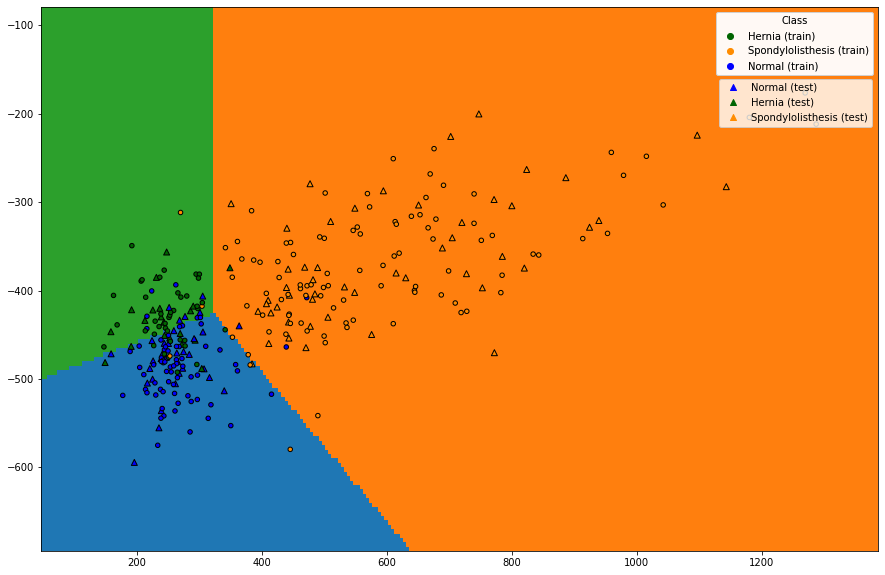

In [134]:
from matplotlib.colors import ListedColormap

X_db = pipe.fit_transform(X_train, y_train)
y_db, labels = pd.factorize(y_train)
# clf = scores.iloc[0].best_estimator

better_decision_boundary(lr, X_train_transformed, y_db, labels, X_test_transformed, y_test)
plt.savefig('Decision_boundary_Logistic_Regression.png')

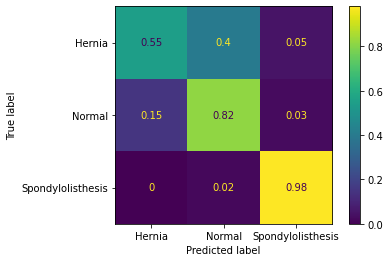

In [132]:
plot_confusion_matrix(lr, X_test_transformed, y_test, normalize='true')
plt.show()

In [26]:

solver_list = ['newton-cg', 'lbfgs', 'sag', 'saga']
parameters = dict(solver=solver_list)
lr = LogisticRegression(random_state=32, multi_class="auto", n_jobs=-1, C=1)
clf = GridSearchCV(lr, parameters, scoring="accuracy", cv=5, return_train_score=True, refit=True)
clf.fit(X_train_transformed, y_train)

scores = clf.cv_results_['mean_test_score']

for score, solver, in zip(scores, solver_list):
    print(f"{solver}: {score:.6f}")

print(clf.best_params_)
print(clf.best_score_)

newton-cg: 0.859001
lbfgs: 0.859001
sag: 0.761905
saga: 0.761905
{'solver': 'newton-cg'}
0.8590011614401858


In [12]:
scaler = MinMaxScaler()
scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train_5c)

In [13]:
lr_sc = LogisticRegression(random_state=32, multi_class="auto", n_jobs=-1, C=1)
clf_sc = GridSearchCV(lr, parameters, scoring="accuracy", cv=5, return_train_score=True, refit=True)

clf_sc.fit(X_train_scaled, y_train)

scores_sc = clf_sc.cv_results_['mean_test_score']

for score_sc, solver_sc, in zip(scores_sc, solver_list):
    print(f"{solver_sc}: {score_sc:.6f}")

print(clf_sc.best_params_)
print(clf_sc.best_score_)

# y_pred_sc = clf.predict(X_test_sc) #Call predict on the estimator with the best found parameters.
# accuracy_score(y_pred_sc, y_test_sc)

newton-cg: 0.834727
lbfgs: 0.834727
sag: 0.834727
saga: 0.834727
{'solver': 'newton-cg'}
0.8347270615563298


In [16]:
X_test_5c = X_test.drop(columns=["pelvic_incidence"])
X_test_5c = scaler.transform(X_test_5c)
y_pred = clf_sc.predict(X_test_5c) #Call predict on the estimator with the best found parameters.
accuracy_score(y_pred, y_test)

0.8252427184466019

On remarque qu'après avoir appliqué le Scaler, les résultats sont meilleurs pour sag et saga mais moins bons dans le meilleur des cas. 

<BarContainer object of 4 artists>

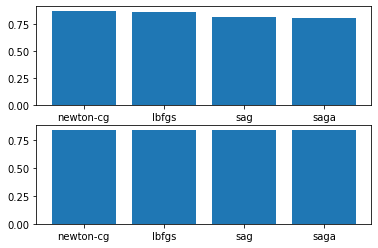

In [97]:
fig, (ax, ax_scale) = plt.subplots(2, 1)
ax.bar(solver_list, scores)
ax_scale.bar(solver_list, scores_sc)

In [25]:
#Interprétation des coefficients

import statsmodels.api as sm

X_train_stat = sm.add_constant(X_train_5c)
y_train_logit = y_train.replace(['Normal'], 'A_Normal')
mlogit = sm.MNLogit(y_train_logit, X_train_stat)
fmlogit = mlogit.fit()
fmlogit.summary()


Optimization terminated successfully.
         Current function value: 0.291962
         Iterations 10


<class 'statsmodels.iolib.summary.Summary'>
"""
                          MNLogit Regression Results                          
==============================================================================
Dep. Variable:                  class   No. Observations:                  206
Model:                        MNLogit   Df Residuals:                      194
Method:                           MLE   Df Model:                           10
Date:                Thu, 11 Jun 2020   Pseudo R-squ.:                  0.7181
Time:                        08:35:26   Log-Likelihood:                -60.144
converged:                       True   LL-Null:                       -213.36
Covariance Type:            nonrobust   LLR p-value:                 6.812e-60
============================================================================================
            class=Hernia       coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                       21.2171      5.360      3.958      0.000      10.711      31.723
pelvic_tilt                  0.0789      0.049      1.619      0.105      -0.017       0.174
lumbar_lordosis_angle       -0.0291      0.044     -0.658      0.510      -0.116       0.058
sacral_slope                -0.1915      0.054     -3.527      0.000      -0.298      -0.085
pelvic_radius               -0.1270      0.036     -3.554      0.000      -0.197      -0.057
degree_spondylolisthesis     0.0283      0.049      0.580      0.562      -0.067       0.124
--------------------------------------------------------------------------------------------
 class=Spondylolisthesis       coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                        0.7895      5.235      0.151      0.880      -9.470      11.049
pelvic_tilt                  0.0877      0.068      1.296      0.195      -0.045       0.220
lumbar_lordosis_angle        0.0128      0.051      0.252      0.801      -0.086       0.112
sacral_slope                 0.0102      0.073      0.140      0.889      -0.132       0.153
pelvic_radius               -0.0607      0.032     -1.910      0.056      -0.123       0.002
degree_spondylolisthesis     0.2803      0.056      5.032      0.000       0.171       0.390
============================================================================================
"""

## Random forest


Scaling is done to Normalize data so that priority is not given to a particular feature. Role of Scaling is mostly important in algorithms that are distance based and require Euclidean Distance.

Random Forest is a tree-based model and hence does not require feature scaling.


In [83]:
def show_params_plot(scores):
    scores.iloc[1].detailed_scores.max_features[scores.iloc[1].detailed_scores.max_features.isna()]=6
    scores.iloc[1].detailed_scores.bootstrap[scores.iloc[1].detailed_scores.bootstrap==True]='True'
    scores.iloc[1].detailed_scores.bootstrap[scores.iloc[1].detailed_scores.bootstrap==False]='False'
    scores.iloc[1].detailed_scores.Accuracy = scores.iloc[1].detailed_scores.Accuracy
    
    fig, axes = plt.subplots(2,2, figsize=(10,10))
    sns.lineplot(x='bootstrap', y='Accuracy', data = scores.iloc[1].detailed_scores, ax=axes[0,0])
    sns.lineplot(x='criterion', y='Accuracy', data = scores.iloc[1].detailed_scores, ax=axes[0,1])
    sns.lineplot(x='max_features', y='Accuracy', data = scores.iloc[1].detailed_scores, ax=axes[1,0])
    sns.lineplot(x='n_estimators', y='Accuracy', data = scores.iloc[1].detailed_scores, ax=axes[1,1])
    
    for laxe in axes:
        for caxe in laxe:
            caxe.set_ylabel('') 
    plt.plot()

In [58]:
parameters = {'criterion':['gini', 'entropy'], 
                  'max_features':[2, 3, 4, 5, None],
                  'n_estimators':[10, 100, 200, 300],
                  'bootstrap':[True, False],
                #   'oob_score':[True, False]
                  }
scores = grid_search(RandomForestClassifier(n_jobs=-1, random_state=42), parameters)


without_pelvic: 86.36
original: 85.40
standard+NCA: 86.89
without_pelvic+standard+NCA: 87.85
minmax+NCA: 84.45
without_pelvic+minmax+NCA: 85.91
NCA: 88.82
without_pelvic+NCA: 85.40
standard+NCA(2): 84.94
without_pelvic+standard+NCA(2): 85.39
minmax+NCA(2): 87.86
without_pelvic+minmax+NCA(2): 88.82
NCA(2): 87.89
without_pelvic+NCA(2): 84.92
standard+ADL: 80.08
without_pelvic+standard+ADL: 80.08
minmax+ADL: 80.08
without_pelvic+minmax+ADL: 80.08
ADL: 88.82
without_pelvic+ADL: 85.40
standard+ADL(2): 80.08
without_pelvic+standard+ADL(2): 80.08
minmax+ADL(2): 80.08
without_pelvic+minmax+ADL(2): 80.08
ADL(2): 87.89
without_pelvic+ADL(2): 84.92
standard: 85.40
without_pelvic+standard: 86.36
minmax: 85.40
without_pelvic+minmax: 86.36
ACP2: 78.13
ACP3: 82.98
ACP4: 85.91
ACP5: 86.40


In [59]:
scores

,method,best_params,best_score,detailed_scores,best_estimator
11,without_pelvic+minmax+NCA(2),"{'bootstrap': True, 'criterion': 'gini', 'max_...",0.888153,bootstrap criterion max_features n_estim...,"(DecisionTreeClassifier(ccp_alpha=0.0, class_w..."
6,NCA,"{'bootstrap': False, 'criterion': 'gini', 'max...",0.888153,bootstrap criterion max_features n_estim...,"(DecisionTreeClassifier(ccp_alpha=0.0, class_w..."
18,ADL,"{'bootstrap': False, 'criterion': 'gini', 'max...",0.888153,bootstrap criterion max_features n_estim...,"(DecisionTreeClassifier(ccp_alpha=0.0, class_w..."
24,ADL(2),"{'bootstrap': True, 'criterion': 'gini', 'max_...",0.878862,bootstrap criterion max_features n_estim...,"(DecisionTreeClassifier(ccp_alpha=0.0, class_w..."
12,NCA(2),"{'bootstrap': True, 'criterion': 'gini', 'max_...",0.878862,bootstrap criterion max_features n_estim...,"(DecisionTreeClassifier(ccp_alpha=0.0, class_w..."
10,minmax+NCA(2),"{'bootstrap': True, 'criterion': 'entropy', 'm...",0.87863,bootstrap criterion max_features n_estim...,"(DecisionTreeClassifier(ccp_alpha=0.0, class_w..."
3,without_pelvic+standard+NCA,"{'bootstrap': False, 'criterion': 'gini', 'max...",0.878513,bootstrap criterion max_features n_estim...,"(DecisionTreeClassifier(ccp_alpha=0.0, class_w..."
2,standard+NCA,"{'bootstrap': True, 'criterion': 'entropy', 'm...",0.868873,bootstrap criterion max_features n_estim...,"(DecisionTreeClassifier(ccp_alpha=0.0, class_w..."
33,ACP5,"{'bootstrap': True, 'criterion': 'gini', 'max_...",0.863995,bootstrap criterion max_features n_estim...,"(DecisionTreeClassifier(ccp_alpha=0.0, class_w..."
29,without_pelvic+minmax,"{'bootstrap': True, 'criterion': 'gini', 'max_...",0.863647,bootstrap criterion max_features n_estim...,"(DecisionTreeClassifier(ccp_alpha=0.0, class_w..."


In [88]:
pipe = Pipeline([('nca', NeighborhoodComponentsAnalysis())])
X_train_transformed = pipe.fit_transform(X_train, y_train)
X_test_transformed = pipe.transform(X_test)

In [92]:
RF = RandomForestClassifier(bootstrap=False,criterion='gini', max_features=4, n_estimators=100).fit(X_train_transformed, y_train)

In [93]:
y_pred = RF.predict(X_test_transformed)
accuracy_score(y_pred=y_pred, y_true=y_test)

0.8349514563106796

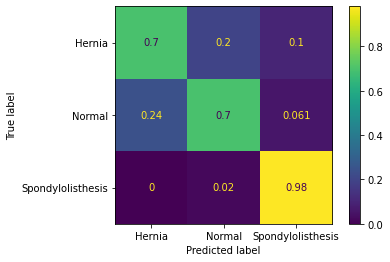

In [94]:
plot_confusion_matrix(RF, X_test_transformed, y_test, normalize='true')
plt.show()

([0, 1, 2, 3, 4, 5], <a list of 6 Text major ticklabel objects>)

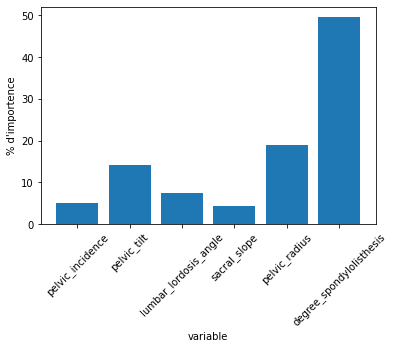

In [63]:
plt.bar(X_train.columns, scores.iloc[1].best_estimator.feature_importances_*100)
plt.ylabel("% d'importence")
plt.xlabel('variable')
plt.xticks(rotation=45)

In [61]:
#Meilleurs paramètres pour le meilleur prétraitement
scores.iloc[1].detailed_scores.iloc[:5]

,bootstrap,criterion,max_features,n_estimators,Accuracy
49,False,gini,4.0,100,0.888153
51,False,gini,4.0,300,0.883391
66,False,entropy,3.0,200,0.878630
44,False,gini,3.0,10,0.878513
50,False,gini,4.0,200,0.878513


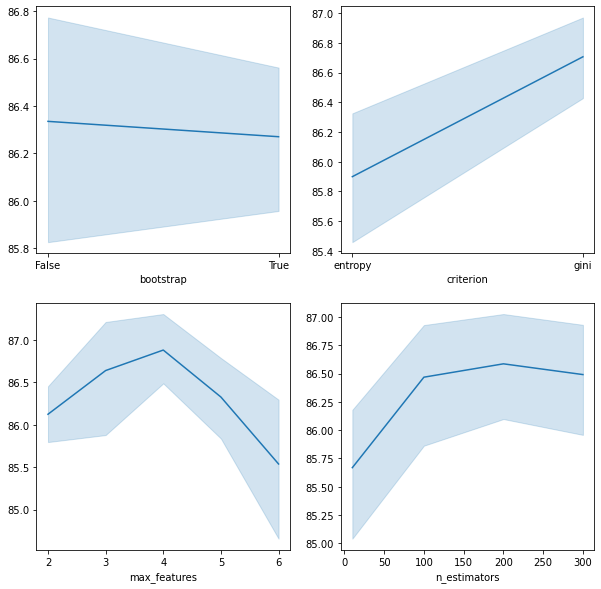

In [84]:
show_params_plot(scores)


# Extra tree
For extra tree, randomness goes one step further in the way splits are computed. As in random forests, a random subset of candidate features is used, but instead of looking for the most discriminative thresholds, thresholds are drawn at random for each candidate feature and the best of these randomly-generated thresholds is picked as the splitting rule. This usually allows to reduce the variance of the model a bit more, at the expense of a slightly greater increase in bias:

In [95]:
parameters = {'criterion':['gini', 'entropy'], 
                  'max_features':[2, 3, 4, 5, None],
                  'n_estimators':[10, 100, 200, 300],
                  'bootstrap':[True, False],
                #   'oob_score':[True, False]
                  }
ETscores = grid_search(ExtraTreesClassifier(n_jobs=-1, random_state=42), parameters)

without_pelvic: 86.86
original: 86.38
standard+NCA: 88.32
without_pelvic+standard+NCA: 87.85
minmax+NCA: 86.86
without_pelvic+minmax+NCA: 87.84
NCA: 90.28
without_pelvic+NCA: 85.42
standard+NCA(2): 89.30
without_pelvic+standard+NCA(2): 87.35
minmax+NCA(2): 89.31
without_pelvic+minmax+NCA(2): 90.28
NCA(2): 89.80
without_pelvic+NCA(2): 87.35
standard+ADL: 82.98
without_pelvic+standard+ADL: 82.98
minmax+ADL: 82.98
without_pelvic+minmax+ADL: 82.98
ADL: 90.28
without_pelvic+ADL: 85.42
standard+ADL(2): 82.98
without_pelvic+standard+ADL(2): 82.98
minmax+ADL(2): 82.98
without_pelvic+minmax+ADL(2): 82.98
ADL(2): 89.80
without_pelvic+ADL(2): 87.35
standard: 86.38
without_pelvic+standard: 86.86
minmax: 86.38
without_pelvic+minmax: 86.86
ACP2: 79.57
ACP3: 81.54
ACP4: 85.44
ACP5: 86.39


In [96]:
ETscores

,method,best_params,best_score,detailed_scores,best_estimator
6,NCA,"{'bootstrap': False, 'criterion': 'entropy', '...",0.902787,bootstrap criterion max_features n_estim...,"(ExtraTreeClassifier(ccp_alpha=0.0, class_weig..."
11,without_pelvic+minmax+NCA(2),"{'bootstrap': True, 'criterion': 'gini', 'max_...",0.902787,bootstrap criterion max_features n_estim...,"(ExtraTreeClassifier(ccp_alpha=0.0, class_weig..."
18,ADL,"{'bootstrap': False, 'criterion': 'entropy', '...",0.902787,bootstrap criterion max_features n_estim...,"(ExtraTreeClassifier(ccp_alpha=0.0, class_weig..."
24,ADL(2),"{'bootstrap': True, 'criterion': 'gini', 'max_...",0.898026,bootstrap criterion max_features n_estim...,"(ExtraTreeClassifier(ccp_alpha=0.0, class_weig..."
12,NCA(2),"{'bootstrap': True, 'criterion': 'gini', 'max_...",0.898026,bootstrap criterion max_features n_estim...,"(ExtraTreeClassifier(ccp_alpha=0.0, class_weig..."
10,minmax+NCA(2),"{'bootstrap': True, 'criterion': 'entropy', 'm...",0.893148,bootstrap criterion max_features n_estim...,"(ExtraTreeClassifier(ccp_alpha=0.0, class_weig..."
8,standard+NCA(2),"{'bootstrap': True, 'criterion': 'gini', 'max_...",0.893031,bootstrap criterion max_features n_estim...,"(ExtraTreeClassifier(ccp_alpha=0.0, class_weig..."
2,standard+NCA,"{'bootstrap': False, 'criterion': 'entropy', '...",0.883159,bootstrap criterion max_features n_estim...,"(ExtraTreeClassifier(ccp_alpha=0.0, class_weig..."
3,without_pelvic+standard+NCA,"{'bootstrap': False, 'criterion': 'entropy', '...",0.878513,bootstrap criterion max_features n_estim...,"(ExtraTreeClassifier(ccp_alpha=0.0, class_weig..."
5,without_pelvic+minmax+NCA,"{'bootstrap': False, 'criterion': 'gini', 'max...",0.878397,bootstrap criterion max_features n_estim...,"(ExtraTreeClassifier(ccp_alpha=0.0, class_weig..."


In [109]:
pipe = Pipeline([('minmax', MinMaxScaler()), ('nca', NeighborhoodComponentsAnalysis(2))])
pipe.fit(X_train_5c, y_train)
X_test_transformed = pipe.transform(X_test_5c)

In [111]:
y_pred = ETscores.iloc[1].best_estimator.predict(X_test_transformed)
accuracy_score(y_pred=y_pred, y_true=y_test)

0.8058252427184466

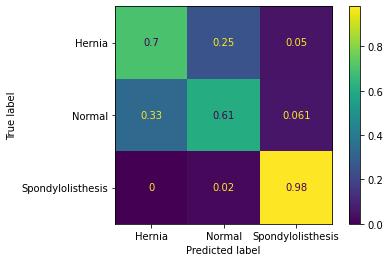

In [112]:
plot_confusion_matrix(ETscores.iloc[1].best_estimator, X_test_transformed, y_test, normalize='true')
plt.show()

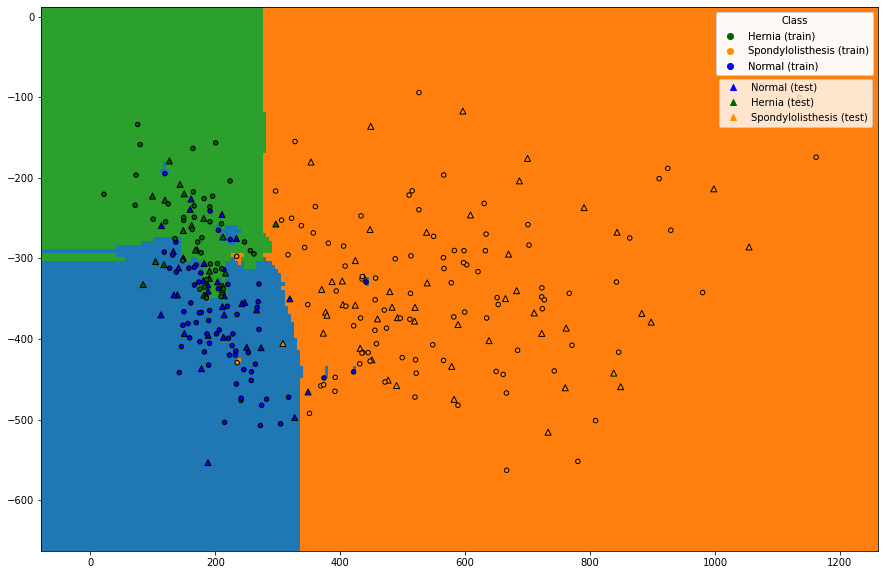

In [115]:
X_db = pipe.fit_transform(X_train_5c, y_train)

y_db, labels = pd.factorize(y_train)

clf = ETscores.iloc[1].best_estimator

better_decision_boundary(clf, X_db, y_db, labels, X_test_transformed, y_test)
plt.savefig('decision_boundary_extra_trees.png')